In [1]:
import numpy as np
import pandas as pd
import networkx as nx

from utils.plot import *

In [2]:
student_mentor = pd.read_csv('../data/processed/author_mentor.csv')
student_mentor

,author,number_publication,year,mentor
0,H. Vincent Poor,1771,1978,John B. Thomas
1,Mohamed-Slim Alouini,1407,1997,Marvin K. Simon
2,Wei Wang,1284,1987,Thomas C. Henderson
3,Lajos Hanzo,1236,1993,Raymond Steele
4,Wen Gao 0001,1190,1995,Jiarong Hong
...,...,...,...,...
1236795,Ümit Özlale,1,2018,Gonca Gürsun
1236796,Ünsal Akaslan,1,2016,Selami Serhatlioglu
1236797,Ünsal Özkuvanci,1,2012,Sadik Kara
1236798,Üyesi Mesut Atasever,1,2019,Witold Chmielarz


In [3]:
gender_book = pd.read_csv('../data/gender/author_gender_filtered.csv')
gender_book

,author,gender,probability
0,H. Vincent Poor,male,0.972930
1,H. V. Jagadish,male,0.936064
2,H. Jonathan Chao,male,0.976723
3,H. T. Kung,male,0.946764
4,H. Jin Kim,male,0.946304
...,...,...,...
1125044,Liaoni Wu,female,1.000000
1125045,Hsinying Liang,female,1.000000
1125046,Gibong Jeong,male,1.000000
1125047,Changri Luo,male,1.000000


In [4]:
student_mentor_filtered = student_mentor[student_mentor['author'].isin(gender_book['author']) & student_mentor['mentor'].isin(gender_book['author'])]
student_mentor_filtered

,author,number_publication,year,mentor
0,H. Vincent Poor,1771,1978,John B. Thomas
1,Mohamed-Slim Alouini,1407,1997,Marvin K. Simon
2,Wei Wang,1284,1987,Thomas C. Henderson
3,Lajos Hanzo,1236,1993,Raymond Steele
6,Yu Zhang,1100,1997,Alan K. Mackworth
...,...,...,...,...
1236788,Øyvind Ødegård-Fougner,1,2018,Ewan Birney
1236792,Ümit Akkus,1,2005,Ugur Güdükbay
1236793,Ümit Keles,1,2019,Özgür Yilmaz
1236794,Ümit Mersinli,1,2012,Ipek Yildiz


In [5]:
g = nx.from_pandas_edgelist(student_mentor_filtered, source='author', target='mentor')

In [6]:
gender_map = dict(zip(gender_book['author'].tolist(), gender_book['gender'].tolist()))

In [7]:
nx.set_node_attributes(g, gender_map, 'gender')

In [8]:
mentor_list = student_mentor_filtered['mentor'].tolist()
mentor_map = dict(zip(mentor_list, np.ones(len(mentor_list),)))

In [9]:
nx.set_node_attributes(g, mentor_map, 'mentor')

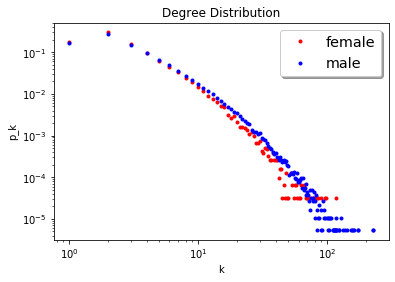

In [10]:
degree_distribution_comparison_plot(g)

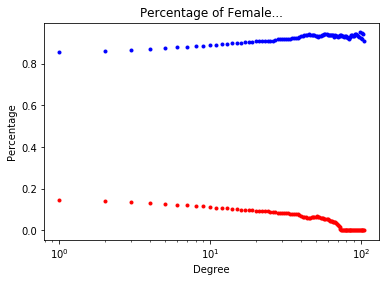

In [11]:
female_degree_fraction_plot(g, 100)

In [12]:
edge_list = pd.read_csv('../data/processed/edge_list.csv')
edge_list

,source,target,year
0,Alejandro P. Buchmann,Frank Manola,1990
1,Alejandro P. Buchmann,Mark F. Hornick,1990
2,Frank Manola,Mark F. Hornick,1990
3,Farshad Nayeri,Joe D. Morrison,1991
4,Farshad Nayeri,Mark F. Hornick,1991
...,...,...,...
21161012,Jürgen Angele,Susanne Neubert,1991
21161013,Rudi Studer,Susanne Neubert,1991
21161014,Ramez Elmasri,Vram Kouramajian,1993
21161015,Claus-Rainer Rollinger,Otthein Herzog,1991


In [13]:
author_list = pd.read_csv('../data/processed/author.csv')
author_list

,author,number_publication,year
0,H. Vincent Poor,1771,1978
1,Mohamed-Slim Alouini,1407,1997
2,Philip S. Yu,1284,1981
3,Wei Wang,1284,1987
4,Wei Zhang,1283,1990
...,...,...,...
2308638,Ünsal Özkuvanci,1,2012
2308639,Üyesi Mesut Atasever,1,2019
2308640,Þröstur Pétursson,1,2015
2308641,Þórir Harðarson,1,2008


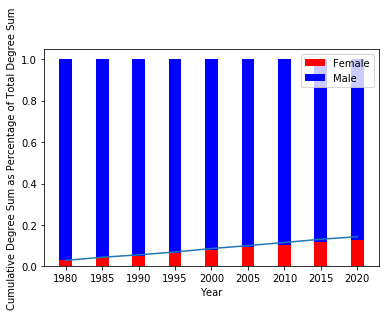

In [14]:
stacked_degree_fraction_over_year_mentor(author_list, edge_list, gender_book, 1980, 2020, 4)

In [15]:
g.edges()


EdgeView([('H. Vincent Poor', 'John B. Thomas'), ('H. Vincent Poor', 'Xiaodong Wang 0001'), ('H. Vincent Poor', 'Urbashi Mitra'), ('H. Vincent Poor', 'Jianwei Huang'), ('H. Vincent Poor', 'Mehul Motani'), ('H. Vincent Poor', 'Zhiguo Ding 0001'), ('H. Vincent Poor', 'Husheng Li'), ('H. Vincent Poor', 'Huaiyu Dai'), ('H. Vincent Poor', 'Behnaam Aazhang'), ('H. Vincent Poor', 'Ravi Tandon'), ('H. Vincent Poor', 'Lalitha Sankar'), ('H. Vincent Poor', 'Sudharman K. Jayaweera'), ('H. Vincent Poor', 'Evaggelos Geraniotis'), ('H. Vincent Poor', 'Erhan Bayraktar'), ('H. Vincent Poor', 'D. Richard Brown III'), ('H. Vincent Poor', 'Jin Young Kim'), ('H. Vincent Poor', 'Scott T. Rickard'), ('H. Vincent Poor', 'Hana Godrich'), ('H. Vincent Poor', 'Eva C. Song'), ('H. Vincent Poor', 'Taragay Oskiper'), ('H. Vincent Poor', 'Richard J. Barton'), ('H. Vincent Poor', 'Olympia Hadjiliadis'), ('H. Vincent Poor', 'Shengshan Cui'), ('H. Vincent Poor', 'Xin Zhang 0004'), ('H. Vincent Poor', 'Jiaping Liu'), (